# Unmanned Aerial Vehicle (UAV) swarm dynamic coordination and control

This exercise focuses on the coordination and control of a swarm of Unmanned Aerial Vehicles (UAVs) to achieve various geometric formations while ensuring collision avoidance and minimising energy consumption. The study involves system modelling, linearisation, state-space representation, control strategies, and performance evaluation. UAV swarm coordination has applications in search and rescue operations, environmental monitoring, and surveillance, requiring synchronised movement, obstacle avoidance, and energy-efficient navigation. The simulation guides UAVs in dynamically forming geometric shapes while optimising their trajectories to enhance overall swarm performance.

## Problem formulation

To accurately model the motion of a drone in a two-dimensional plane, a mathematical representation is developed based on fundamental physical principles. The formulation accounts for the influence of control inputs, external disturbances, and interaction forces, providing a comprehensive framework for analysing the system's behaviour.

### Governing equations

The dynamics of a drone in a two-dimensional plane are governed by Newton's laws of motion. The state of a drone is described by its position $(x, y)$ and velocity $(v_x, v_y)$ in the $x$ and $y$ directions, respectively. The control inputs are the forces $(F_x, F_y)$ applied in the $x$ and $y$ directions, respectively. Additionally, the drone is subject to external disturbances $(D_x, D_y)$ and thrust forces $(T_x, T_y)$, as well as repulsion forces $(R_x, R_y)$.

#### Nonlinear equations of motion

The nonlinear equations of motion are given by:

$$
\begin{aligned}
\dot{x} &= v_x \\
\dot{y} &= v_y \\
\dot{v_x} &= \frac{1}{m} (F_x + D_x + T_x - c v_x^2 \, \text{sgn}(v_x) - k \sin(\theta) + R_x) \\
\dot{v_y} &= \frac{1}{m} (F_y + D_y + T_y - c v_y^2 \, \text{sgn}(v_y) - k \cos(\theta) + R_y)
\end{aligned}
$$

where:

-   $(x, y)$ are the coordinates of the drone,
-   $(v_x, v_y)$ are the velocities in the $x$ and $y$ directions,
-   $F_x$ and $F_y$ are the control forces in the $x$ and $y$ directions,
-   $m$ is the mass of the drone,
-   $D_x$ and $D_y$ represent external disturbances (e.g., wind forces),
-   $T_x$ and $T_y$ represent thrust forces,
-   $c$ is the drag coefficient,
-   $k$ represents gravitational and other forces acting on the drone,
-   $\theta$ is the angle of the drone relative to the horizontal plane,
-   $\text{sgn}(v)$ is the sign function, which accounts for the direction of the drag force,
-   $R_x$ and $R_y$ are the repulsive forces in the $x$ and $y$ directions, respectively, and will be computed based on the distances between drones.

### Linearisation and state-space representation

Linearisation involves approximating the nonlinear system with a linear model around a specific operating point. This is achieved by computing the Jacobian matrices of the system equations. Define the state vector $\mathbf{x}$, input vector $\mathbf{u}$, disturbance vector $\mathbf{d}$, and thrust vector $\mathbf{t}$ as follows:

$$
\mathbf{x} = \begin{bmatrix}
x \\
y \\
v_x \\
v_y
\end{bmatrix}, \quad
\mathbf{u} = \begin{bmatrix}
F_x \\
F_y
\end{bmatrix}, \quad
\mathbf{d} = \begin{bmatrix}
D_x \\
D_y
\end{bmatrix}, \quad
\mathbf{t} = \begin{bmatrix}
T_x \\
T_y
\end{bmatrix}, \quad
\mathbf{r} = \begin{bmatrix}
R_x \\
R_y
\end{bmatrix}
$$

The state-space representation of the system is given by:

$$
\dot{\mathbf{x}} = \mathbf{A} \mathbf{x} + \mathbf{B} \mathbf{u} + \mathbf{E} \mathbf{d} + \mathbf{T} \mathbf{t} + \mathbf{R} \mathbf{r}
$$

where $\mathbf{A}$, $\mathbf{B}$, $\mathbf{E}$, $\mathbf{T}$, and $\mathbf{R}$ are the system matrices.

#### Linearised matrices

The linearised system matrices $\mathbf{A}$ and $\mathbf{B}$, considering the effect of external disturbances and thrust forces, are derived by computing the Jacobians of the system equations with respect to the state and input vectors. For simplicity, we assume small perturbations around the operating point where $\theta \approx 0$ and the velocities are small.

$$
\mathbf{A} = \begin{bmatrix}
0 & 0 & 1 & 0 \\
0 & 0 & 0 & 1 \\
0 & 0 & -\frac{2c v_x}{m} & 0 \\
0 & 0 & 0 & -\frac{2c v_y}{m}
\end{bmatrix}, \quad
\mathbf{B} = \begin{bmatrix}
0 & 0 \\
0 & 0 \\
\frac{1}{m} & 0 \\
0 & \frac{1}{m}
\end{bmatrix}, \\
\mathbf{E} = \begin{bmatrix}
0 & 0 \\
0 & 0 \\
\frac{1}{m} & 0 \\
0 & \frac{1}{m}
\end{bmatrix}, \quad
\mathbf{T} = \begin{bmatrix}
0 & 0 \\
0 & 0 \\
\frac{1}{m} & 0 \\
0 & \frac{1}{m}
\end{bmatrix}
$$

### Control models

#### Proportional-Integral-Derivative (PID) control

PID control is a widely used control strategy that combines proportional, integral, and derivative actions to compute the control input. The PID control law is given by:

$$
\mathbf{u}(t) = \mathbf{K}_p \mathbf{e}(t) + \mathbf{K}_i \int \mathbf{e}(t) \, dt + \mathbf{K}_d \frac{d\mathbf{e}(t)}{dt}
$$

where $\mathbf{e}(t)$ is the error between the desired state and the current state, and $\mathbf{K}_p$, $\mathbf{K}_i$, $\mathbf{K}_d$ are the proportional, integral, and derivative gains, respectively.

The error $\mathbf{e}(t)$ is defined as:

$$
\mathbf{e}(t) = \mathbf{x}_{\text{desired}}(t) - \mathbf{x}(t)
$$

In discrete form, the PID control law can be implemented as:

$$
\mathbf{u}[k] = \mathbf{K}_p \mathbf{e}[k] + \mathbf{K}_i \sum_{i=0}^{k} \mathbf{e}[i] \Delta t + \mathbf{K}_d \frac{\mathbf{e}[k] - \mathbf{e}[k-1]}{\Delta t}
$$

where $k$ denotes the discrete time step and $\Delta t$ is the time step size.

#### Linear Quadratic Regulator (LQR)

LQR is an optimal control strategy that aims to minimise a quadratic cost function. The cost function is defined as:

$$
J = \int_0^\infty (\mathbf{x}^T \mathbf{Q} \mathbf{x} + \mathbf{u}^T \mathbf{R} \mathbf{u}) \, dt
$$

where $\mathbf{Q}$ and $\mathbf{R}$ are weight matrices that penalise deviations in the state and control input, respectively. The LQR control law is given by:

$$
\mathbf{u} = -\mathbf{K} \mathbf{x}
$$

where $\mathbf{K}$ is the optimal gain matrix calculated as:

$$
\mathbf{K} = \mathbf{R}^{-1} \mathbf{B}^T \mathbf{P}
$$

and $\mathbf{P}$ is the solution to the continuous-time algebraic Riccati equation:

$$
\mathbf{A}^T \mathbf{P} + \mathbf{P} \mathbf{A} - \mathbf{P} \mathbf{B} \mathbf{R}^{-1} \mathbf{B}^T \mathbf{P} + \mathbf{Q} = 0
$$

### Initial and boundary conditions

Initial conditions specify the starting state of the drones, while boundary conditions define the target positions for each drone. For this exercise:

-   **Initial positions**: The initial positions $(x_0, y_0)$ of the drones are randomly generated within a specified area. For example, within a 10x10 grid centered at the origin:
    $$
    x_0, y_0 \sim \mathcal{U}(-5, 5)
    $$
    where $\mathcal{U}$ denotes the uniform distribution.
-   **Target positions**: The target positions are determined based on the desired geometric formation (e.g., star, hexagon, square, circle, triangle). These positions are defined a priori and serve as the setpoints for the control strategies.

### Performance metrics

Performance metrics are used to evaluate the effectiveness of the control strategies. The key metrics include:

-   **Energy consumption**: The total energy consumed by the drones to reach the target positions. This can be quantified as:

    $$
    E = \int_0^T (\mathbf{u}^T \mathbf{u}) \, dt
    $$

-   **Position error**: The deviation between the drones' final positions and the target positions. This can be measured as:

    $$
    e_{\text{final}} = \|\mathbf{x}_{\text{desired}} - \mathbf{x}_{\text{final}}\|
    $$

-   **Collision avoidance**: The ability of the drones to avoid collisions during the alignment process. This can be monitored by ensuring that the distance between any two drones remains above a minimum threshold:

    $$
    \|\mathbf{x}_i - \mathbf{x}_j\| \geq d_{\text{min}} \quad \forall i, j
    $$

-   **Stability**: The ability of the drones to maintain the target formation over time. This can be assessed by observing the deviation from the target positions over a sustained period.

### Model assumptions

The following assumptions are made for the simplification of the model:

-   **Point masses**: The drones are modelled as point masses with no rotational dynamics.
-   **Neglecting environmental disturbances**: External disturbances such as wind are considered in the model as $\mathbf{d}$ but are assumed to be manageable and small.
-   **Instantaneous control forces**: The control forces are directly proportional to the applied inputs, with no time delay.
-   **Collision avoidance**: The interactions between drones are limited to collision avoidance by including repulsive forces when drones are within a certain distance of each other.


## Implementation


### Parameter definition and initialisation

Define the physical parameters of the rocket and the environment, such as the mass of the rocket, gravitational acceleration, drag coefficient, air density, and reference area. These values are crucial for accurately modelling the rocket's dynamics.


In [2]:
# Import libraries
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
from scipy.linalg import solve_continuous_are
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

# Seed for reproducibility
np.random.seed(73)

# Ensure interactive plots in Jupyter Notebook
%matplotlib widget
plt.close("all")

# Global constants
m = 0.25  # Mass of the drone (kg)
c = 0.1  # Drag coefficient
num_drones = 20  # Number of drones in the swarm
dim_grid = num_drones / 4  # Used to define the space domain

# Time step and simulation time
dt = 0.1  # Time step in seconds
total_time = 15.0  # Total simulation time (seconds)
time_steps = int(total_time / dt)

# Generates random external disturbances for each drone over time
disturbances = np.random.normal(0, 0.3, (time_steps, num_drones, 2))

# Generates thrust vectors for each drone over time
thrusts = np.random.normal(0, 0.1, (time_steps, num_drones, 2))

# Parameters for collision avoidance
d_min = 1.0  # Minimum distance between drones


### Geometric formation generation

Generate various geometric formations that the UAV swarm will adopt. These formations include circle, square, triangle, hexagon, and star shapes.


In [3]:
def generate_formation(shape, num_drones, dim_grid=5):
    """
    Generates target positions based on the specified geometric shape.

    Parameters
    ----------
    shape : str
        The geometric shape of the formation.
    num_drones : int
        The number of drones in the swarm.
    dim_grid : float, optional
        The size of the grid where the formation is placed.

    Returns
    -------
    numpy.ndarray
        The target positions of the drones.
    """
    positions = []

    if shape == "circle":
        angles = np.linspace(0, 2 * np.pi, num_drones, endpoint=False)
        positions = np.c_[dim_grid * np.cos(angles), dim_grid * np.sin(angles)]
    elif shape == "hexagon":
        angles = np.linspace(0, 2 * np.pi, 6, endpoint=False)
        positions = np.c_[dim_grid * np.cos(angles), dim_grid * np.sin(angles)]
        positions = positions[:num_drones]
    elif shape == "star":
        angles_outer = np.linspace(0, 2 * np.pi, 5, endpoint=False)
        angles_inner = angles_outer + np.pi / 5
        radius_outer = dim_grid
        radius_inner = dim_grid / 2.0
        positions_outer = np.c_[
            radius_outer * np.cos(angles_outer), radius_outer * np.sin(angles_outer)
        ]
        positions_inner = np.c_[
            radius_inner * np.cos(angles_inner), radius_inner * np.sin(angles_inner)
        ]
        positions_combined = np.vstack((positions_outer, positions_inner))
        positions = positions_combined[:num_drones]
    else:
        raise ValueError("Unknown shape specified")

    # Ensure the number of positions matches the number of drones
    positions = np.tile(positions, (num_drones // len(positions) + 1, 1))[:num_drones]
    return positions


# List of formation shapes
formation_shapes = ["circle", "hexagon", "star"]

### State-space representation

The state-space representation is a mathematical model of the UAV dynamics. The the state-space matrices $\mathbf{A}, \mathbf{B}, \mathbf{E}, \mathbf{T}$ are constructed based on the system parameters.


In [4]:
def compute_state_space_matrices(c, m):
    """
    Computes the state-space matrices for the drone model.

    Parameters
    ----------
    c : float
        Drag coefficient.
    m : float
        Mass of the drone.

    Returns
    -------
    numpy.ndarray
        The state-space matrix A.
    numpy.ndarray
        The control matrix B.
    numpy.ndarray
        The disturbance matrix E.
    numpy.ndarray
        The measurement matrix T.
    """
    A = np.array(
        [[0, 0, 1, 0], [0, 0, 0, 1], [0, 0, -2 * c / m, 0], [0, 0, 0, -2 * c / m]]
    )
    B = np.array([[0, 0], [0, 0], [1 / m, 0], [0, 1 / m]])
    E = np.array([[0, 0], [0, 0], [1 / m, 0], [0, 1 / m]])
    T = np.array([[0, 0], [0, 0], [1 / m, 0], [0, 1 / m]])
    return A, B, E, T


# Compute state-space matrices
A, B, E, T = compute_state_space_matrices(c, m)

# Visualise state-space matrices for verification
print("State-space matrix A:\n", A)
print("Control matrix B:\n", B)

State-space matrix A:
 [[ 0.   0.   1.   0. ]
 [ 0.   0.   0.   1. ]
 [ 0.   0.  -0.8  0. ]
 [ 0.   0.   0.  -0.8]]
Control matrix B:
 [[0. 0.]
 [0. 0.]
 [4. 0.]
 [0. 4.]]


#### Controllability check

A system is controllable if it is possible to move the system from any initial state to any desired final state within a finite time using appropriate control inputs. For a linear time-invariant (LTI) system represented by the matrices $\mathbf{A}$ and $\mathbf{B}$, the controllability matrix $\mathbf{C}$ is defined as:

$$
\mathbf{C} = \begin{bmatrix} \mathbf{B} & \mathbf{A}\mathbf{B} & \mathbf{A}^2\mathbf{B} & \cdots & \mathbf{A}^{n-1}\mathbf{B} \end{bmatrix}
$$

The system is controllable if the controllability matrix $\mathbf{C}$ has full rank, i.e., the rank of $\mathbf{C}$ is equal to the number of states $n$.


In [5]:
def is_controllable(A, B):
    """
    Checks if the system is controllable.

    Parameters
    ----------
    A : numpy.ndarray
        The state-space matrix A.
    B : numpy.ndarray
        The control matrix B.

    Returns
    -------
    bool
        True if the system is controllable, False otherwise.
    """
    # Number of states
    n = A.shape[0]
    # Construct the controllability matrix
    controllability_matrix = np.hstack(
        [np.linalg.matrix_power(A, i) @ B for i in range(n)]
    )
    # Compute the rank of the controllability matrix
    rank = np.linalg.matrix_rank(controllability_matrix)
    # Check if the rank is equal to the number of states
    return rank == n


# Check controllability
controllable = is_controllable(A, B)
if controllable:
    print("The system is controllable.")
else:
    print("The system is not controllable.")

The system is controllable.


### PID controller

The Proportional-Integral-Derivative (PID) controller is designed to correct deviations from a desired state by applying a control input based on the proportional, integral, and derivative terms of the error.

-   Proportional term (P): Reacts to the current error.
-   Integral term (I): Accumulates past errors to remove steady-state error.
-   Derivative term (D): Predicts future error trends by considering the rate of change of error.

The control gains $\mathbf{K}_p$, $\mathbf{K}_i$, and $\mathbf{K}_d$ are chosen to tune the response of the system.


In [6]:
class PIDController:
    """
    Defines a PID controller for the UAV.

    Parameters
    ----------
    Kp : numpy.ndarray
        The proportional gain values for each state dimension.
    Ki : numpy.ndarray
        The integral gain values for each state dimension.
    Kd : numpy.ndarray
        The derivative gain values for each state dimension.
    dt : float
        The time step of the simulation.
    state_dim : int, optional

    Attributes
    ----------
    Kp : numpy.ndarray
        The proportional gain values for each state dimension.
    Ki : numpy.ndarray
        The integral gain values for each state dimension.
    Kd : numpy.ndarray
        The derivative gain values for each state dimension.
    dt : float
        The time step of the simulation.
    integral_error : numpy.ndarray
        The integral error for each state dimension.
    prev_error : numpy.ndarray
        The previous error for each state dimension.

    Methods
    -------
    control(state, target_state)
        Computes the control input based on the PID control law.
    reset()
        Resets the integral and previous error terms.
    """

    # Defines a PID controller for the UAV
    def __init__(self, Kp, Ki, Kd, dt, state_dim=4):
        """
        Parameters
        ----------
        Kp : numpy.ndarray
            The proportional gain values for each state dimension.
        Ki : numpy.ndarray
            The integral gain values for each state dimension.
        Kd : numpy.ndarray
            The derivative gain values for each state dimension.
        dt : float
            The time step of the simulation.
        state_dim : int, optional
            The number of state dimensions.
        """
        self.Kp = Kp
        self.Ki = Ki
        self.Kd = Kd
        self.dt = dt
        self.integral_error = np.zeros(state_dim)
        self.prev_error = np.zeros(state_dim)

    def control(self, state, target_state):
        """
        Computes the control input based on the PID control law.

        Parameters
        ----------
        state : numpy.ndarray
            The current state of the drone.
        target_state : numpy.ndarray
            The target state of the drone.

        Returns
        -------
        numpy.ndarray
            The control input for all state dimensions.
        """
        # Computes the control input based on the PID control law
        error = target_state - state
        self.integral_error += error * self.dt
        derivative_error = (error - self.prev_error) / self.dt
        self.prev_error = error

        control_input = (
            self.Kp * error + self.Ki * self.integral_error + self.Kd * derivative_error
        )

        # Return control input for all state dimensions
        return control_input[:2]

    def reset(self):
        """
        Resets the integral and previous error terms.
        """
        # Reset the integral and previous error terms
        self.integral_error = np.zeros_like(self.integral_error)
        self.prev_error = np.zeros_like(self.prev_error)


# Gain values
Kp = 0.12 * np.array([1.0, 1.0, 1.0, 1.0])
Ki = 0.01 * np.array([1.0, 1.0, 1.0, 1.0])
Kd = 0.25 * np.array([1.0, 1.0, 1.0, 1.0])

# Initialise LQR controllers for each drone
pid_controllers = [PIDController(Kp, Ki, Kd, dt) for _ in range(num_drones)]

### Linear-quadratic regulator design and control law

The Linear Quadratic Regulator (LQR) controller is designed to minimise a cost function that penalises deviations from the desired state and the control effort. The weighting matrices $\mathbf{Q}$ and $\mathbf{R}$ are chosen to balance these penalties. The optimal gain matrix $\mathbf{K}$ is computed by solving the Continuous-time Algebraic Riccati Equation (CARE).


In [7]:
class LQRController:
    """
    Defines an LQR controller for the UAV.

    Parameters
    ----------
    A : numpy.ndarray
        The state-space matrix A.
    B : numpy.ndarray
        The control matrix B.
    Q : numpy.ndarray
        The state penalty matrix Q.
    R : numpy.ndarray
        The control penalty matrix R.

    Attributes
    ----------
    A : numpy.ndarray
        The state-space matrix A.
    B : numpy.ndarray
        The control matrix B.
    Q : numpy.ndarray
        The state penalty matrix Q.
    R : numpy.ndarray
        The control penalty matrix R.
    K : numpy.ndarray
        The optimal feedback gain matrix K.

    Methods
    -------
    control(state, target_state)
        Computes the LQR control input based on current and target states.
    """

    # Defines an LQR controller for the UAV
    def __init__(self, A, B, Q, R):
        """
        Parameters
        ----------
        A : numpy.ndarray
            The state-space matrix A.
        B : numpy.ndarray
            The control matrix B.
        Q : numpy.ndarray
            The state penalty matrix Q.
        R : numpy.ndarray
            The control penalty matrix R.
        """
        self.A = A
        self.B = B
        self.Q = Q
        self.R = R
        self.K = self.compute_lqr_gain()

    def compute_lqr_gain(self):
        """
        Computes the optimal feedback gain matrix K.

        Returns
        -------
        numpy.ndarray
            The optimal feedback gain matrix K.
        """
        # Solve the Algebraic Riccati Equation for P
        P = solve_continuous_are(self.A, self.B, self.Q, self.R)

        # Compute the optimal feedback gain matrix K
        K = np.linalg.inv(self.R) @ self.B.T @ P

        return K

    def control(self, state, target_state):
        """
        Computes the LQR control input based on current and target states.

        Parameters
        ----------
        state : numpy.ndarray
            The current state of the drone.
        target_state : numpy.ndarray
            The target state of the drone.

        Returns
        -------
        numpy.ndarray
            The LQR control input for the drone.
        """
        # Computes the LQR control input based on current and target states
        error = state - target_state
        control_input = -self.K @ error

        return control_input


# Q penalises deviations from the desired state
Q = np.diag([1, 1, 1, 1])

# R penalises the magnitude of the control inputs
R = np.diag([0.5, 0.5])

# Initialise LQR controllers for each drone
lqr_controllers = [LQRController(A, B, Q, R) for _ in range(num_drones)]

### Collision avoidance forces

Define the repulsive forces based on the distances between drones using a potential field method to calculate these forces:

$$
\mathbf{R}_i = \sum_{j \neq i} k_r\frac{(d_{\text{min}} - \|\mathbf{x}_i - \mathbf{x}_j\|)}{\|\mathbf{x}_i - \mathbf{x}_j\|} (\mathbf{x}_i - \mathbf{x}_j)
$$

where:

-   $k_r$ is the strength of the repulsive force,
-   $d_{\text{min}}$ is the minimum distance between drones,
-   $\|\mathbf{x}_i - \mathbf{x}_j\|$ is the distance between drone $i$ and drone $j$.


In [8]:
def collision_avoidance_forces(states, d_min, strength=10):
    """
    Computes the collision avoidance forces between drones.

    Parameters
    ----------
    states : numpy.ndarray
        The current states of the drones.
    d_min : float
        The minimum distance between drones.
    strength : float, optional
        The strength of the collision avoidance forces.

    Returns
    -------
    numpy.ndarray
        The collision avoidance forces between drones.
    """
    forces = np.zeros((num_drones, 2))
    for i in range(num_drones):
        for j in range(num_drones):
            if i != j:
                distance = np.linalg.norm(states[i, :2] - states[j, :2])
                if distance < d_min:
                    direction = states[i, :2] - states[j, :2]
                    force = strength * (d_min - distance) * direction / distance
                    forces[i] += force
    return forces

### Numerical simulation

The numerical simulation updates the state of each drone over time considering the control inputs, disturbances, and thrusts.


In [9]:
def simulate_dynamics(
    state, control_input, A, B, E, T, dt, disturbance, thrust, repulsive_force
):
    """
    Simulates the drone dynamics for one time step.

    Parameters
    ----------
    state : numpy.ndarray
        The current state of the drone.
    control_input : numpy.ndarray
        The control input for the drone.
    A : numpy.ndarray
        The state-space matrix A.
    B : numpy.ndarray
        The control matrix B.
    E : numpy.ndarray
        The disturbance matrix E.
    T : numpy.ndarray
        The measurement matrix T.
    dt : float
        The time step of the simulation.
    disturbance : numpy.ndarray
        The external disturbance acting on the drone.
    thrust : numpy.ndarray
        The thrust vector acting on the drone.
    repulsive_force : numpy.ndarray
        The repulsive force acting on the drone.

    Returns
    -------
    numpy.ndarray
        The next state of the drone.
    """
    # Simulates the drone dynamics for one time step, including disturbances and thrust
    state_dot = A @ state + B @ control_input + E @ disturbance + T @ thrust
    state_dot[:2] += repulsive_force  # Add repulsive force to the position dynamics
    next_state = state + state_dot * dt

    return next_state

## Results


### Complete simulation

Simulates the UAV swarm movement using the specified controller, including disturbances and thrusts.


In [10]:
def simulate_formation_change(
    initial_states, target_positions, disturbances, thrusts, controller_type="PID"
):
    """
    Simulates the formation change of a swarm of drones over time.

    Parameters
    ----------
    initial_states : numpy.ndarray
        The initial states of the drones.
    target_positions : numpy.ndarray
        The target positions of the drones.
    disturbances : numpy.ndarray
        The external disturbances acting on the drones.

    Returns
    -------
    list
        The states of the drones over time.
    list
        The control inputs of the drones over time.
    """
    states = initial_states.copy()
    states_history = [states.copy()]
    control_inputs_history = []

    for t in range(time_steps):
        control_inputs = np.zeros((num_drones, 2))
        for i in range(num_drones):
            state = states[i]
            target_state = np.hstack(
                (target_positions[i], [0, 0])
            )  # Desired velocities are zero

            if controller_type == "PID":
                controller = pid_controllers[i]
                control_input = controller.control(state, target_state)
            elif controller_type == "LQR":
                controller = lqr_controllers[i]
                control_input = controller.control(state, target_state)

            control_inputs[i] = control_input

            # Get current disturbance and thrust for the drone
            disturbance = disturbances[t, i]
            thrust = thrusts[t, i]

            # Calculate collision avoidance forces
            collision_forces = collision_avoidance_forces(states, d_min)

            # Update state
            states[i] = simulate_dynamics(
                state,
                control_input,
                A,
                B,
                E,
                T,
                dt,
                disturbance,
                thrust,
                collision_forces[i],
            )

        states_history.append(states.copy())
        control_inputs_history.append(control_inputs.copy())

    return states_history, control_inputs_history


### Performance metrics

Compute the total energy consumption based on control inputs over time, the mean position error over all drones and time steps, the average deviation over the last $n$ steps, and the collision avoidance for the performance evaluation of the control strategies.


In [11]:
def compute_performance_metrics(
    states_history, control_inputs_history, target_positions, dt, d_min=1
):
    """
    Computes performance metrics for the formation change of a swarm of drones.

    Parameters
    ----------
    states_history : list
        The states of the drones over time.
    control_inputs_history : list
        The control inputs of the drones over time.
    target_positions : numpy.ndarray
        The target positions of the drones.
    dt : float
        The time step of the simulation.
    d_min : float, optional
        The minimum distance between drones.

    Returns
    -------
    dict
        The performance metrics for the formation change.
    """
    # Calculate energy consumption
    energy_consumption = sum(np.sum(u**2) * dt for u in control_inputs_history)

    # Calculate final position error
    final_positions = states_history[-1][:, :2]
    position_error = np.linalg.norm(final_positions - target_positions, axis=1).mean()

    # Calculate stability (average deviation over the last n steps)
    steps = 50  # Number of steps to consider
    stability_error = np.mean(
        [
            np.linalg.norm(states_history[-i][:, :2] - target_positions, axis=1).mean()
            for i in range(1, steps + 1)
        ]
    )

    # Calculate collision avoidance
    collision_avoidance = np.all(
        [
            np.linalg.norm(
                states_history[-i][:, :2] - states_history[-i][:, :2][np.newaxis, :],
                axis=-1,
            ).min()
            >= d_min
            for i in range(1, steps + 1)
        ]
    )

    return {
        "Energy consumption": energy_consumption,
        "Position error": position_error,
        "Stability error": stability_error,
        "Collision avoidance": collision_avoidance,
    }


Create an animation of the UAV swarm moving towards the target formation.


In [12]:
def animate_swarm(
    pid_states_histories,
    lqr_states_histories,
    target_positions_list,
    formation_shapes,
    dim_grid=5,
):
    """
    Animates the swarm of drones for the PID and LQR controllers.

    Parameters
    ----------
    pid_states_histories : list
        The states of the drones over time for the PID controller.
    lqr_states_histories : list
        The states of the drones over time for the LQR controller.
    target_positions_list : list
        The target positions of the drones.
    formation_shapes : list
        The geometric shapes of the formations.
    dim_grid : float, optional

    Returns
    -------
    matplotlib.animation.FuncAnimation
        The animation of the swarm of drones.
    """
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(13, 6))

    for ax in (ax1, ax2):
        ax.set_xlim(-(1.4 * dim_grid), (1.4 * dim_grid))
        ax.set_ylim(-(1.4 * dim_grid), (1.4 * dim_grid))
        ax.set_xlabel("X position")
        ax.set_ylabel("Y position")

    ax1.set_title("PID controller")
    ax2.set_title("LQR controller")

    pid_drones_scatter = ax1.scatter([], [], color="blue", label="PID drones")
    lqr_drones_scatter = ax2.scatter([], [], color="green", label="LQR drones")

    pid_target_scatters = [
        ax1.scatter([], [], color="red", marker="x", label="Target positions")
    ]
    lqr_target_scatters = [
        ax2.scatter([], [], color="red", marker="x", label="Target positions")
    ]

    formation_text_pid = ax1.text(
        0.05, 0.95, "", transform=ax1.transAxes, fontsize=12, verticalalignment="top"
    )
    formation_text_lqr = ax2.text(
        0.05, 0.95, "", transform=ax2.transAxes, fontsize=12, verticalalignment="top"
    )

    ax1.legend(loc="upper right")
    ax2.legend(loc="upper right")

    def init():
        """Initialise the animation."""
        pid_drones_scatter.set_offsets(np.empty((0, 2)))
        lqr_drones_scatter.set_offsets(np.empty((0, 2)))
        pid_target_scatters[0].set_offsets(np.empty((0, 2)))
        lqr_target_scatters[0].set_offsets(np.empty((0, 2)))
        formation_text_pid.set_text("")
        formation_text_lqr.set_text("")
        return (
            pid_drones_scatter,
            lqr_drones_scatter,
            pid_target_scatters[0],
            lqr_target_scatters[0],
            formation_text_pid,
            formation_text_lqr,
        )

    def update(frame):
        """Update the animation."""
        formation_index, step_index = frame
        pid_positions = pid_states_histories[formation_index][step_index][:, :2]
        lqr_positions = lqr_states_histories[formation_index][step_index][:, :2]
        target_positions = target_positions_list[formation_index]

        pid_drones_scatter.set_offsets(pid_positions)
        lqr_drones_scatter.set_offsets(lqr_positions)
        pid_target_scatters[0].set_offsets(target_positions)
        lqr_target_scatters[0].set_offsets(target_positions)

        formation_name = formation_shapes[formation_index]
        formation_text_pid.set_text(f"Formation: {formation_name}")
        formation_text_lqr.set_text(f"Formation: {formation_name}")

        return (
            pid_drones_scatter,
            lqr_drones_scatter,
            pid_target_scatters[0],
            lqr_target_scatters[0],
            formation_text_pid,
            formation_text_lqr,
        )

    frames = [
        (i, j)
        for i in range(len(pid_states_histories))
        for j in range(len(pid_states_histories[i]))
    ]

    ani = FuncAnimation(
        fig,
        update,
        frames=frames,
        init_func=init,
        blit=True,
        interval=50,
        cache_frame_data=False,
    )

    plt.close(fig)
    return ani

Run simulations.


In [13]:
target_positions_list = []
pid_states_histories = []
lqr_states_histories = []
pid_performance_metrics = []
lqr_performance_metrics = []

# Generate initial random positions
initial_positions = np.random.uniform(-dim_grid, dim_grid, (num_drones, 2))
initial_states_pid = np.hstack((initial_positions, np.zeros((num_drones, 2))))
initial_states_lqr = initial_states_pid.copy()

for shape in formation_shapes:
    target_positions = generate_formation(shape, num_drones, dim_grid)
    target_positions_list.append(target_positions)

    # Reset PID controllers before each formation change
    for controller in pid_controllers:
        controller.reset()

    # PID Controller
    pid_states_history, pid_control_inputs_history = simulate_formation_change(
        initial_states_pid,
        target_positions,
        disturbances,
        thrusts,
        controller_type="PID",
    )
    pid_states_histories.append(pid_states_history)
    pid_metrics = compute_performance_metrics(
        pid_states_history, pid_control_inputs_history, target_positions, dt, d_min
    )
    pid_performance_metrics.append(pid_metrics)

    # LQR Controller
    lqr_states_history, lqr_control_inputs_history = simulate_formation_change(
        initial_states_lqr,
        target_positions,
        disturbances,
        thrusts,
        controller_type="LQR",
    )
    lqr_states_histories.append(lqr_states_history)
    lqr_metrics = compute_performance_metrics(
        lqr_states_history, lqr_control_inputs_history, target_positions, dt, d_min
    )
    lqr_performance_metrics.append(lqr_metrics)

    # Update initial states for the next formation
    final_positions = pid_states_history[-1][:, :2]
    initial_states_pid = np.hstack((final_positions, np.zeros((num_drones, 2))))
    final_positions = lqr_states_history[-1][:, :2]
    initial_states_lqr = np.hstack((final_positions, np.zeros((num_drones, 2))))

### Visualisation of results


Perform step response analysis for PID and LQR controllers and plot the results.


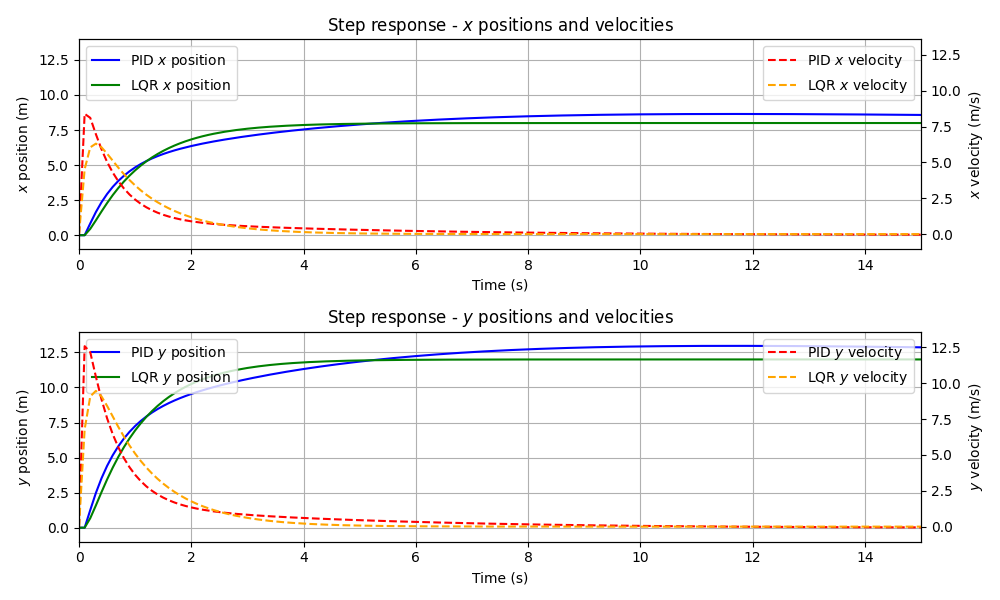

In [14]:
def step_response_analysis(
    initial_state, target_state, pid_controller, lqr_controller, time_steps, dt
):
    """
    Analyse the step response of the PID and LQR controllers.

    Parameters
    ----------
    initial_state : numpy.ndarray
        The initial state of the drone.
    target_state : numpy.ndarray
        The target state of the drone.
    pid_controller : PIDController
        The PID controller for the drone.
    lqr_controller : LQRController
        The LQR controller for the drone.
    time_steps : int
        The number of time steps to simulate.
    dt : float
        The time step of the simulation.
    """
    pid_states = [initial_state]
    lqr_states = [initial_state]
    pid_control_inputs = []
    lqr_control_inputs = []

    for t in range(time_steps):
        pid_state = pid_states[-1]
        lqr_state = lqr_states[-1]

        pid_control_input = pid_controller.control(pid_state, target_state)
        lqr_control_input = lqr_controller.control(lqr_state, target_state)

        pid_control_inputs.append(pid_control_input)
        lqr_control_inputs.append(lqr_control_input)

        # Simulate the dynamics for the next state
        pid_state_dot = A @ pid_state + B @ pid_control_input
        lqr_state_dot = A @ lqr_state + B @ lqr_control_input

        pid_next_state = pid_state + pid_state_dot * dt
        lqr_next_state = lqr_state + lqr_state_dot * dt

        pid_states.append(pid_next_state)
        lqr_states.append(lqr_next_state)

    pid_states = np.array(pid_states)
    lqr_states = np.array(lqr_states)
    time = np.linspace(0, time_steps * dt, time_steps + 1)

    # Plot the responses with two y-axes for positions and velocities
    fig, ax = plt.subplots(2, 1, figsize=(10, 6))

    # X positions and X velocities
    ax[0].plot(time, pid_states[:, 0], label="PID $x$ position", color="blue")
    ax[0].plot(time, lqr_states[:, 0], label="LQR $x$ position", color="green")
    ax[0].set_ylabel("$x$ position (m)")
    ax[0].legend(loc="upper left")
    ax[0].set_xlabel("Time (s)")

    ax_x_vel = ax[0].twinx()
    ax_x_vel.plot(
        time, pid_states[:, 2], label="PID $x$ velocity", color="red", linestyle="--"
    )
    ax_x_vel.plot(
        time, lqr_states[:, 2], label="LQR $x$ velocity", color="orange", linestyle="--"
    )
    ax_x_vel.set_ylabel("$x$ velocity (m/s)")
    ax_x_vel.legend(loc="upper right")

    ax[0].set_title("Step response - $x$ positions and velocities")
    ax[0].grid(True)

    # Y positions and Y velocities
    ax[1].plot(time, pid_states[:, 1], label="PID $y$ position", color="blue")
    ax[1].plot(time, lqr_states[:, 1], label="LQR $y$ position", color="green")
    ax[1].set_ylabel("$y$ position (m)")
    ax[1].legend(loc="upper left")
    ax[1].set_xlabel("Time (s)")

    ax_y_vel = ax[1].twinx()
    ax_y_vel.plot(
        time, pid_states[:, 3], label="PID $y$ velocity", color="red", linestyle="--"
    )
    ax_y_vel.plot(
        time, lqr_states[:, 3], label="LQR $y$ velocity", color="orange", linestyle="--"
    )
    ax_y_vel.set_ylabel("$y$ velocity (m/s)")
    ax_y_vel.legend(loc="upper right")

    ax[1].set_title("Step response - $y$ positions and velocities")
    ax[1].grid(True)

    # Set the same xlim and ylim for both plots
    ax[0].set_xlim([0, time_steps * dt])
    ax[1].set_xlim([0, time_steps * dt])
    ax[0].set_ylim(
        [
            np.min([pid_states[:, 0:2], lqr_states[:, 0:2]]) - 1,
            np.max([pid_states[:, 0:2], lqr_states[:, 0:2]]) + 1,
        ]
    )
    ax[1].set_ylim(
        [
            np.min([pid_states[:, 0:2], lqr_states[:, 0:2]]) - 1,
            np.max([pid_states[:, 0:2], lqr_states[:, 0:2]]) + 1,
        ]
    )
    ax_x_vel.set_ylim(
        [
            np.min([pid_states[:, 2:4], lqr_states[:, 2:4]]) - 1,
            np.max([pid_states[:, 2:4], lqr_states[:, 2:4]]) + 1,
        ]
    )
    ax_y_vel.set_ylim(
        [
            np.min([pid_states[:, 2:4], lqr_states[:, 2:4]]) - 1,
            np.max([pid_states[:, 2:4], lqr_states[:, 2:4]]) + 1,
        ]
    )

    plt.tight_layout()
    plt.show()


# Initialise states
initial_state = np.array([0, 0, 0, 0])
target_state = np.array([8, 12, 0, 0])

# Initialize PID and LQR controllers
pid_controller = PIDController(Kp, Ki, Kd, dt)
lqr_controller = LQRController(A, B, Q, R)

step_response_analysis(
    initial_state, target_state, pid_controller, lqr_controller, time_steps, dt
)

Plot performance metrics


,PID energy consumption,LQR energy consumption,PID position error,LQR position error,PID stability error,LQR stability error,PID collision avoidance,LQR collision avoidance
circle,608.588142,235.936716,0.619771,0.059381,0.674326,0.059201,0,0
hexagon,701.536931,247.432072,0.747842,0.606139,0.784059,0.608403,0,0
star,707.355624,252.437592,0.674676,0.480632,0.692175,0.481194,0,0


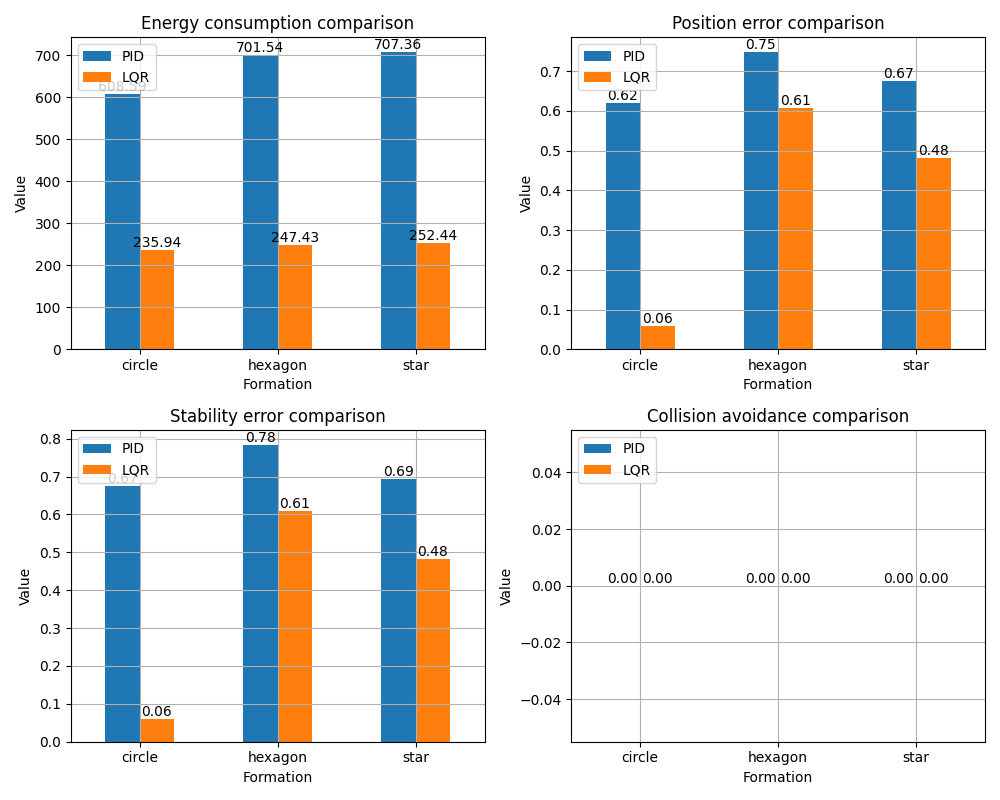

In [15]:
# Data setup
data = {
    "PID energy consumption": [
        metrics["Energy consumption"] for metrics in pid_performance_metrics
    ],
    "LQR energy consumption": [
        metrics["Energy consumption"] for metrics in lqr_performance_metrics
    ],
    "PID position error": [
        metrics["Position error"] for metrics in pid_performance_metrics
    ],
    "LQR position error": [
        metrics["Position error"] for metrics in lqr_performance_metrics
    ],
    "PID stability error": [
        metrics["Stability error"] for metrics in pid_performance_metrics
    ],
    "LQR stability error": [
        metrics["Stability error"] for metrics in lqr_performance_metrics
    ],
    "PID collision avoidance": [
        int(metrics["Collision avoidance"]) for metrics in pid_performance_metrics
    ],
    "LQR collision avoidance": [
        int(metrics["Collision avoidance"]) for metrics in lqr_performance_metrics
    ],
}

# Convert all DataFrame columns to numeric, coerce any errors to NaN
df = pd.DataFrame(data, index=formation_shapes)
df = df.apply(pd.to_numeric, errors="coerce")
display(df)


# Create a subplot layout
fig, axes = plt.subplots(2, 2, figsize=(10, 8))

# List of metrics and their titles
metrics_list = [
    ("PID energy consumption", "LQR energy consumption", "Energy consumption"),
    ("PID position error", "LQR position error", "Position error"),
    ("PID stability error", "LQR stability error", "Stability error"),
    ("PID collision avoidance", "LQR collision avoidance", "Collision avoidance"),
]

# Plot each metric on a separate subplot
for ax, (metric1, metric2, metric_name) in zip(axes.flat, metrics_list):
    df[[metric1, metric2]].plot(kind="bar", ax=ax)

    # Add labels to bars
    for p in ax.patches:
        height = p.get_height()
        ax.annotate(
            f"{height:.2f}",
            (p.get_x() + p.get_width() / 2.0, height),
            ha="center",
            va="bottom",
        )

    # Set legend to show only PID and LQR
    ax.legend(["PID", "LQR"], loc="upper left")

    # Plot setup
    ax.set_title(f"{metric_name} comparison")
    ax.set_xlabel("Formation")
    ax.set_ylabel("Value")
    ax.set_xticks(list(range(len(formation_shapes))))
    ax.set_xticklabels(formation_shapes, rotation=0)
    ax.grid(True)


# Adjust layout and show the plot
plt.tight_layout()
plt.show()


Display sequential animations for PID and LQR controllers.


In [16]:
# Display sequential animations for PID and LQR Controllers
print("Sequential animation for all formations")

sequential_animation = animate_swarm(
    pid_states_histories,
    lqr_states_histories,
    target_positions_list,
    formation_shapes,
    dim_grid,
)

display(HTML(sequential_animation.to_jshtml()))

Sequential animation for all formations
